# **[Supervised Workflow]** Remote Sensing Analysis of Mangrove Forest Health and Extent in the Grand-Pierre Bay, Artibonite, Haiti 
## Analysis and Figures
<hr>

Written by Alexandre Erich Sebastien Georges, *PhD Student at UC Berkeley in EFMH-Civil and Environmental Engineering*, August 2023

In [1]:
import sys
sys.path.append('/global/home/users/alexandregeorges/Chapter1/')

from codebase.params import *
from codebase.utils import *
from codebase.metrics import *
from codebase.figures import *

import itertools, glob, re, copy

from ipywidgets import FloatProgress
from datetime import datetime
from joblib import dump, load

import cv2 as cv
import numpy as np
import xarray as xr
import pandas as pd
import geopandas as gpd
import rioxarray as rxr
import earthpy.plot as ep
import matplotlib.pyplot as plt

import matplotlib as mpl
import matplotlib.patches as mpatches
from matplotlib import colors as colors_mat

from tqdm.notebook import tqdm

import seaborn as sns
from sklearn.linear_model import LinearRegression

#mpl.rcParams.update({'font.size': 40})

In [2]:
# functions to set up import for
## utils: aoi_path, paths_to_datetimeindex
## metrics: moa_calc, get_metrics, ndvi_calc, uvvr_calc

In [3]:
# Setting notebook wide dpi for figures
image_quality = 400

# Importing Data

Site Selection

In [4]:
# Options include : ['CCHT', 'GSHT', 'BRHT', 'COHT', 'IVHT', 'AQHT', 'MGHT', 'ARHT', 'OKHT']
site_code = 'GPHT'
aoi_list = [site_code]

In [5]:
data_dir = DOWNLOAD_DIR_ROOT + site_code + '/'+ '*.tif'

# Timestamps for acquired raster files
times = [i.strftime('%m-%d-%Y') for i in paths_to_datetimeindex(glob.glob(data_dir))]
time_var = xr.Variable('Observation Date', times)

Masked Data

In [6]:
obs = xr.open_dataset(OBS_PREFIX+site_code+'_obs.nc')
obs

<xarray.Dataset>
Dimensions:      (y: 3737, x: 2439, band: 7)
Coordinates:
  * y            (y) float64 2.15e+06 2.15e+06 2.15e+06 ... 2.132e+06 2.132e+06
  * x            (x) float64 7.333e+05 7.333e+05 ... 7.455e+05 7.455e+05
  * band         (band) int32 1 2 3 4 5 6 7
Data variables: (12/74)
    01-15-2010   (band, y, x) float32 ...
    01-23-2010   (band, y, x) float32 ...
    01-28-2010   (band, y, x) float32 ...
    02-02-2010   (band, y, x) float32 ...
    04-05-2010   (band, y, x) float32 ...
    05-08-2010   (band, y, x) float32 ...
    ...           ...
    12-30-2018   (band, y, x) float32 ...
    12-27-2019   (band, y, x) float32 ...
    01-11-2020   (band, y, x) float32 ...
    01-20-2020   (band, y, x) float32 ...
    02-12-2020   (band, y, x) float32 ...
    spatial_ref  int32 ...
Attributes:
    AREA_OR_POINT:  Area
    _FillValue:     nan
    scale_factor:   1.0
    add_offset:     0.0

Classified Data

In [7]:
ds = xr.open_dataset(CLASSIFIED_PREFIX+site_code+'_classified.nc')
ds

<xarray.Dataset>
Dimensions:   (y: 3737, x: 2439, time: 73)
Coordinates:
  * y         (y) float64 2.15e+06 2.15e+06 2.15e+06 ... 2.132e+06 2.132e+06
  * x         (x) float64 7.333e+05 7.333e+05 7.333e+05 ... 7.455e+05 7.455e+05
  * time      (time) object '01-15-2010' '01-23-2010' ... '02-12-2020'
Data variables:
    water     (time, y, x) bool ...
    mangrove  (time, y, x) bool ...
    mudflat   (time, y, x) bool ...
    crop      (time, y, x) bool ...
    urban     (time, y, x) bool ...
Attributes:
    description:  Classified categories for each observation time

In [8]:
mangroveSites = ds['mangrove']
unvegSites = ds['mudflat']

# Plots

Basemap from original observation for site

In [9]:
data_dir = DOWNLOAD_DIR_ROOT + site_code + '/'+ '*.tif'
base = rxr.open_rasterio(sort_observations(data_dir)[0])
base = base.where(base != 0)

## Mangrove Cover Change

In [10]:
# Cover Change Calculation
# Setting values to first and last observations
first = np.where(ds['mangrove'][0] == 0, 4, 0)
last = np.where(ds['mangrove'][-1] == 0, 2, 0)
# Summing values to find pixels showing change
change = first + last
# Removing Pixels with no change
change_mask = np.ma.masked_where(change == 0, change)

/global/home/users/alexandregeorges/.conda/envs/MangroveRS/lib/python3.11/site-packages/earthpy/spatial.py:561: RuntimeWarning: invalid value encountered in cast
  return (bytedata.clip(low, high) + 0.5).astype("uint8")


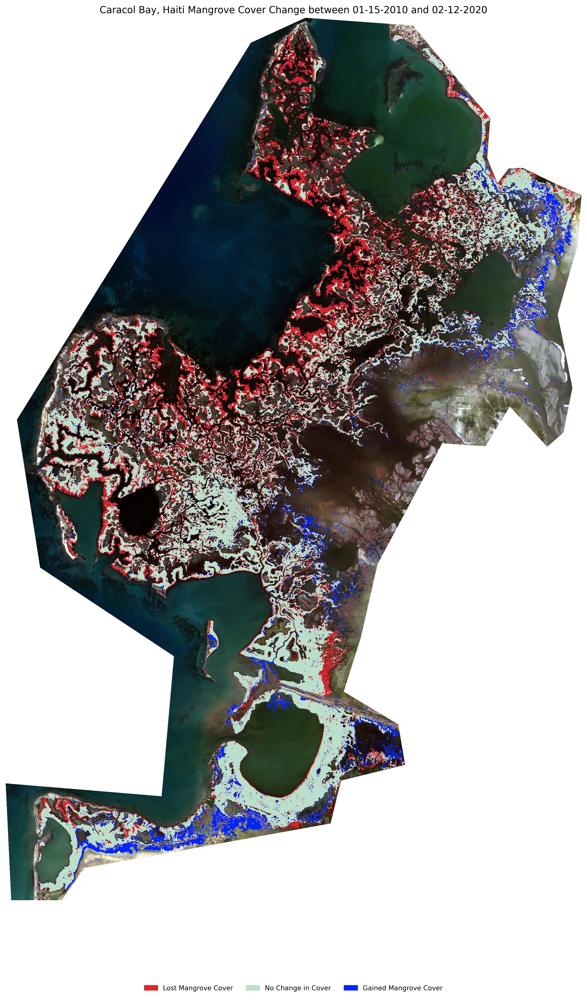

In [11]:
# Plotting Change
fig, ax = plt.subplots(figsize=(20,20), dpi=image_quality)

custom_cmap = colors_mat.ListedColormap(['#0025FC', '#D7262F', '#BBDFCB'])
boundaries = [0, 2, 4, 6]
custom_norm = colors_mat.BoundaryNorm(boundaries, custom_cmap.N, clip=True)

patches = [mpatches.Patch(color='#D7262F', label='Lost Mangrove Cover'),
            mpatches.Patch(color='#BBDFCB', label='No Change in Cover'),
            mpatches.Patch(color='#0025FC', label='Gained Mangrove Cover')]

ep.plot_rgb(base, rgb=[2,1,0], stretch=True,
            str_clip=.09, ax=ax)
ax.imshow(change_mask, cmap=custom_cmap)
ax.set_title('Caracol Bay, Haiti Mangrove Cover Change between '+times[0]+' and '+times[-1]);

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

ax.legend(handles=patches, fontsize='small', loc='center', bbox_to_anchor=(0.5, -0.1), fancybox=False, ncol=3, frameon=False)
ax.patch.set_facecolor('xkcd:white')

plt.show()

## Masking NDVI using Mangrove Cover

In [12]:
%%time
masked_obs = xr.map_blocks(mask_dataset, obs, [ds])
masked_obs

CPU times: user 11.3 s, sys: 14.9 s, total: 26.1 s
Wall time: 35.8 s


<xarray.Dataset>
Dimensions:      (band: 7, y: 3737, x: 2439)
Coordinates:
  * y            (y) float64 2.15e+06 2.15e+06 2.15e+06 ... 2.132e+06 2.132e+06
  * x            (x) float64 7.333e+05 7.333e+05 ... 7.455e+05 7.455e+05
  * band         (band) int32 1 2 3 4 5 6 7
    time         <U10 '01-15-2010'
Data variables: (12/74)
    01-15-2010   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    01-23-2010   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    01-28-2010   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    02-02-2010   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    04-05-2010   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    05-08-2010   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    ...           ...
    12-30-2018   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    12-27-2019   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    01-11-2020   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    01-20-2020   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    02-12-2020   (band, y, x) float32 nan nan nan nan nan ... nan nan nan nan
    spatial_ref  (y, x) float64 nan nan nan nan nan nan ... nan nan nan nan nan
Attributes:
    AREA_OR_POINT:  Area
    _FillValue:     nan
    scale_factor:   1.0
    add_offset:     0.0

## Percent NDVI Change in Mangrove (dNDVI)

In [13]:
dndvi = (masked_obs[times[-1]][-1] - masked_obs[times[0]][-1])
dndvi_perc = 100*((masked_obs[times[-1]][-1] - masked_obs[times[0]][-1])/masked_obs[times[0]][-1])

In [14]:
print('Min: ' + str(dndvi.min()) + '\nMax: ' + str(dndvi.max()))

Min: <xarray.DataArray ()>
array(-1.02681589)
Coordinates:
    band     int32 7
    time     <U10 '01-15-2010'
Max: <xarray.DataArray ()>
array(0.9788785)
Coordinates:
    band     int32 7
    time     <U10 '01-15-2010'


In [15]:
print('Min: ' + str(dndvi_perc.min()) + '\nMax: ' + str(dndvi_perc.max()))

Min: <xarray.DataArray ()>
array(-inf)
Coordinates:
    band     int32 7
    time     <U10 '01-15-2010'
Max: <xarray.DataArray ()>
array(inf)
Coordinates:
    band     int32 7
    time     <U10 '01-15-2010'


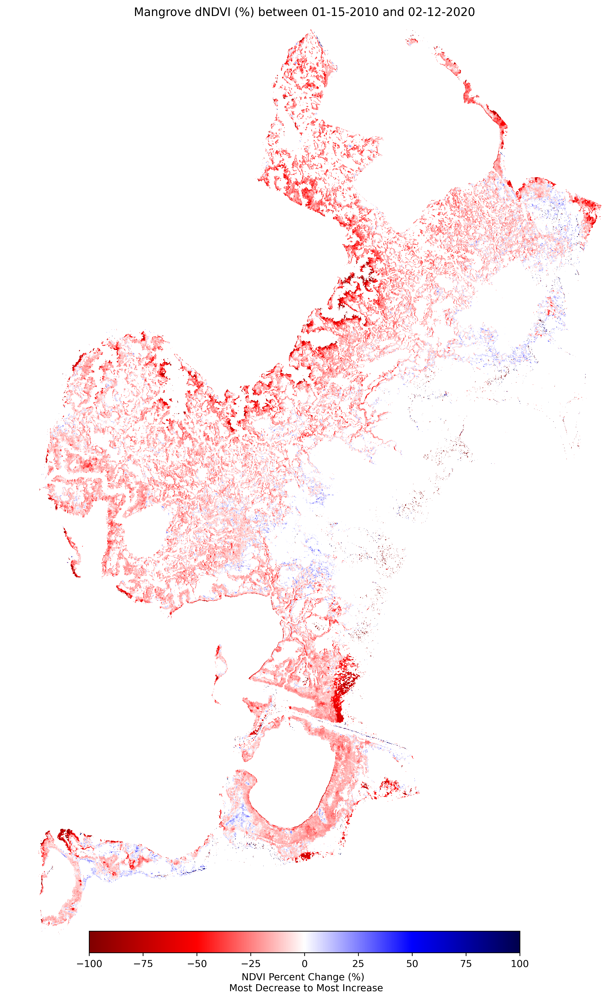

In [16]:
# Plotting Change
fig, ax = plt.subplots(figsize=(20,20), dpi=image_quality)

ax.set_title('Mangrove dNDVI (%) between '+times[0]+' and '+times[-1], loc='center')
divnorm = colors_mat.TwoSlopeNorm(vmin=-100,vcenter=0,vmax=100)

nd = ax.imshow(dndvi_perc, cmap='seismic_r', norm=divnorm)
plt.colorbar(nd, ax=ax, location='bottom', shrink=0.4, pad=-0.0025, label='NDVI Percent Change (%) \n Most Decrease to Most Increase')

ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_xticks([])
ax.set_yticks([])

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

#plt.savefig('../outputs/Final Figures/dNDVI_Creative.png', dpi=1000, bbox_inches='tight', transparent=True)
plt.show()


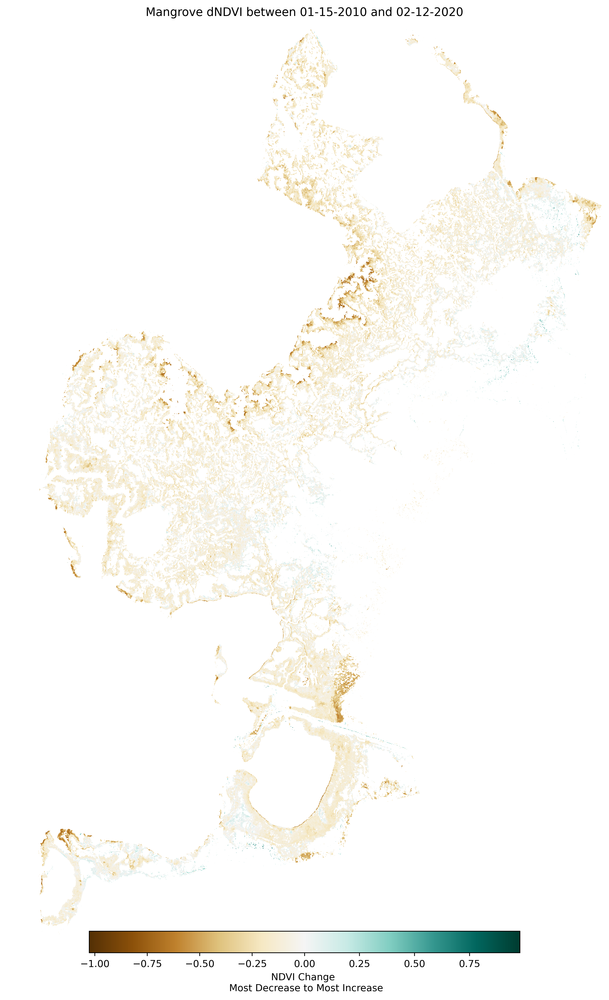

In [17]:
# Plotting Change
fig, ax = plt.subplots(figsize=(20,20), dpi=image_quality)

ax.set_title('Mangrove dNDVI between '+times[0]+' and '+times[-1], loc='center')
divnorm = colors_mat.TwoSlopeNorm(vcenter=0)

nd = ax.imshow(dndvi, cmap='BrBG', norm=divnorm)
plt.colorbar(nd, ax=ax, location='bottom', shrink=0.4, pad=-0.0025, label='NDVI Change \n Most Decrease to Most Increase')

ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_xticks([])
ax.set_yticks([])

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

#plt.savefig('../outputs/Final Figures/dNDVI_Creative.png', dpi=1000, bbox_inches='tight', transparent=True)
plt.show()


## NDVI Bins Animation

MovieWriter ffmpeg unavailable; using Pillow instead.
/global/home/users/alexandregeorges/.conda/envs/MangroveRS/lib/python3.11/site-packages/PIL/Image.py:3157: DecompressionBombWarning: Image size (100000000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


CPU times: user 12min 22s, sys: 2min 12s, total: 14min 35s
Wall time: 14min 39s


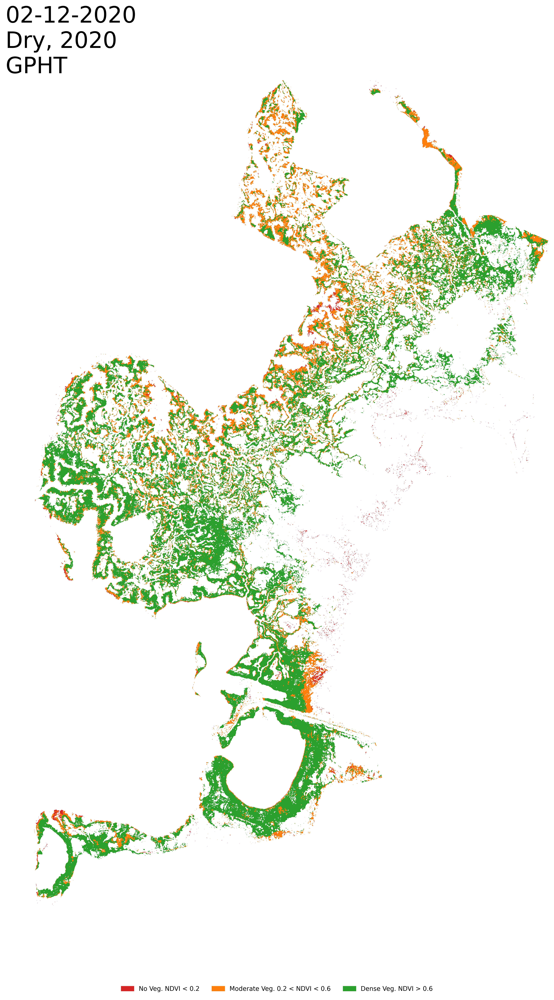

In [18]:
%%time
animate_ndvi_maps(masked_obs, times, site_code)

## NDVI Stats

In [19]:
data = data_prep(masked_obs, times)
data['NDVI'] = data['NDVI'].apply(clean_df)
data['Mean'] = data['NDVI'].apply(np.mean)
data['Median'] = data['NDVI'].apply(np.median)
data['Stdev'] = data['NDVI'].apply(np.std)
data['Min'] = data['NDVI'].apply(np.min)
data['Max'] = data['NDVI'].apply(np.max)
data['Var'] = data['NDVI'].apply(np.var)
data

NDVI  \
water_year season                                                      
2010       Dry     [-0.10720887035131454, -0.09928352385759354, 0...   
           Wet     [0.03695014491677284, 0.01550387591123581, -0....   
2011       Dry     [0.027568921446800232, 0.04026402533054352, -0...   
           Wet     [-0.06400363147258759, -0.03775620460510254, -...   
2012       Dry     [0.11005917191505432, 0.13080169260501862, 0.3...   
           Wet     [0.23794341087341309, 0.10000000149011612, 0.2...   
2013       Dry     [-0.1434977650642395, 0.10659898817539215, 0.3...   
           Wet     [0.27981293201446533, 0.20555555820465088, 0.3...   
2014       Dry     [-0.024251069873571396, 0.22056832909584045, 0...   
           Wet     [0.09315375983715057, 0.23379629850387573, 0.1...   
2015       Dry     [0.17217391729354858, 0.11912225931882858, 0.3...   
           Wet     [0.006839945446699858, 0.2213592231273651, 0.2...   
2016       Dry     [0.11737088859081268, 0.1284153014421463, 0.15...   
           Wet     [0.019064124673604965, 0.11846689879894257, -0...   
2017       Wet     [-0.04387197643518448, -0.009480919688940048, ...   
2018       Dry     [-0.017766498029232025, -0.06010929122567177, ...   
           Wet     [0.11235955357551575, 0.16011236608028412, 0.3...   
2019       Dry     [0.10085470229387283, 0.21551723778247833, 0.2...   
2020       Dry     [0.14750289916992188, 0.03873744606971741, 0.3...   

                       Mean    Median     Stdev       Min       Max       Var  
water_year season                                                              
2010       Dry     0.658689  0.690878  0.171584 -0.428256  0.978501  0.029441  
           Wet     0.503441  0.523971  0.134400 -0.271230  0.893018  0.018063  
2011       Dry     0.573774  0.580064  0.174247 -0.412587  0.974296  0.030362  
           Wet     0.524909  0.548688  0.154362 -0.312063  0.952330  0.023828  
2012       Dry     0.521837  0.535398  0.165979 -0.303435  0.946771  0.027549  
           Wet     0.602035  0.637051  0.174668 -0.381023  0.937225  0.030509  
2013       Dry     0.679600  0.685853  0.215636 -0.397418  0.999495  0.046499  
           Wet     0.546608  0.559369  0.202729 -0.981982  0.998734  0.041099  
2014       Dry     0.584022  0.615844  0.193516 -0.367367  0.975965  0.037449  
           Wet     0.541440  0.565733  0.161602 -0.290590  0.893885  0.026115  
2015       Dry     0.596624  0.621227  0.179185 -0.510079  0.944008  0.032107  
           Wet     0.525212  0.543471  0.186183 -0.469468  0.993506  0.034664  
2016       Dry     0.642263  0.680634  0.198780 -0.406176  0.999358  0.039513  
           Wet     0.620000  0.659284  0.185568 -0.427088  0.976401  0.034435  
2017       Wet     0.501675  0.539632  0.202330 -0.743000  0.999476  0.040937  
2018       Dry     0.640777  0.681449  0.200442 -0.493987  0.977912  0.040177  
           Wet     0.591832  0.619977  0.177097 -0.492901  0.940957  0.031363  
2019       Dry     0.705333  0.758405  0.185982 -0.419948  0.980355  0.034589  
2020       Dry     0.670194  0.717450  0.180472 -0.375174  0.957951  0.032570

## NDVI BoxPlot Timeseries

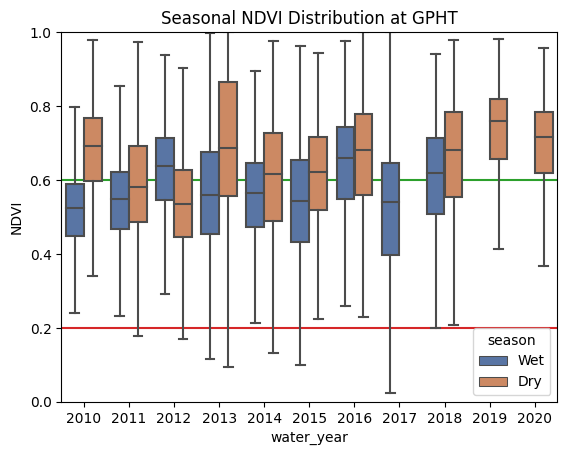

CPU times: user 3min 38s, sys: 27.5 s, total: 4min 5s
Wall time: 4min 5s


In [20]:
%%time 
data_box = data_prep_box(masked_obs, times)
plot_box(data_box, site_code)

## NDVI Ridgeplots

CPU times: user 8min 55s, sys: 8.9 s, total: 9min 4s
Wall time: 5min 56s


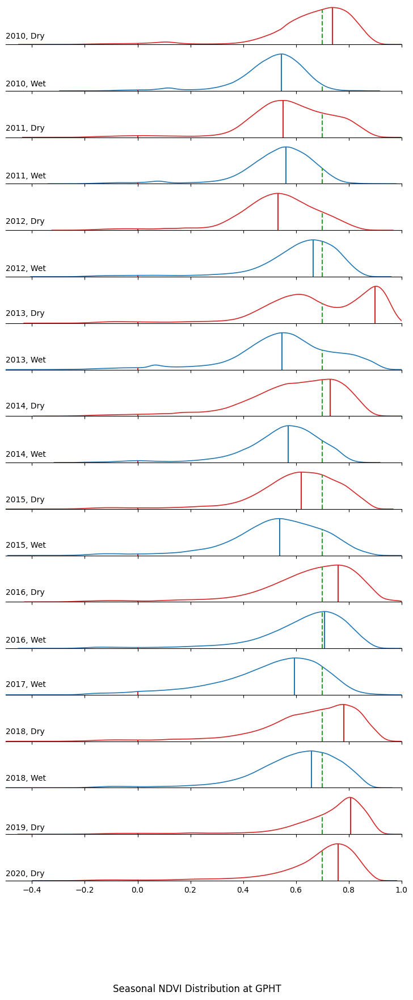

In [21]:
%%time
#data = data_prep(masked_obs, times)
sn_ridgeplots(data, site_code)

## Trend Trajectories

In [22]:
font = {'family' : 'sans-serif',
        'weight' : 'regular',
        'size'   : 32}

mpl.rc('font', **font)

In [23]:
metrics_healthy = get_metrics([mangroveSites], times)

[-6.058525]


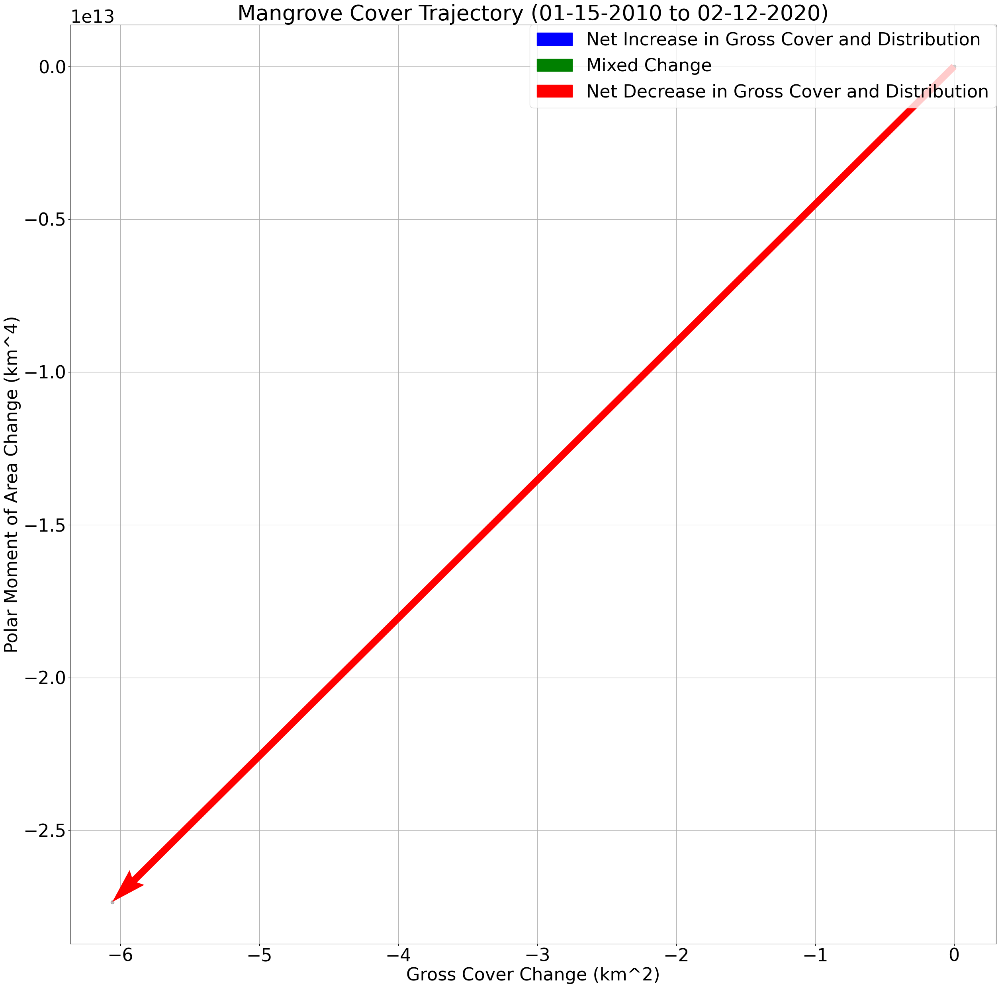

In [24]:
metrics_visualization(metrics_healthy, aoi_list, 'Mangrove Cover Trajectory ('+times[0]+' to '+times[-1]+')')

## UVVR and NDVI Timeseries

### UVVR Timeseries
The unvegetated-vegetated marsh ratio (UVVR) is a spatially integrative metric that correlates with sediment budgets and sea-level rise *(Ganju et al. 2017)*; it is defined as:

$$ UVVR = \frac{A_{uv}}{A_v}$$ 

where Auv is the unvegetated area within a specified domain, and Av is the vegetated area. The total area of the wetland domain, Ad, is the sum of Auv and Av and the vegetated fraction, Fv, is therefore: <br>

$$ F_v = \frac{A_v}{A_d} $$ 

<br>
Unvegetated areas can represent bare sediment, pools, channels, and intertidal flats. Vegetated areas are typically wetland plain areas, and in a “binary” context, any vegetated plain, regardless of stem density, would be considered vegetated at some nominal spatial scale.

In [25]:
from scipy import stats

def get_conf_int(alpha, lr, X, y):
    
    """
    Returns (1-alpha) 2-sided confidence intervals
    for sklearn.LinearRegression coefficients
    as a pandas DataFrame
    """
    
    coefs = np.r_[[lr.intercept_], lr.coef_]
    X_aux = X.copy()
    X_aux.insert(0, 'const', 1)
    dof = -np.diff(X_aux.shape)[0]
    mse = np.sum((y - lr.predict(X)) ** 2) / dof
    var_params = np.diag(np.linalg.inv(X_aux.T.dot(X_aux)))
    t_val = stats.t.isf(alpha/2, dof)
    gap = t_val * np.sqrt(mse * var_params)

    return pd.DataFrame({
        'lower': coefs - gap, 'upper': coefs + gap
    }, index=X_aux.columns)


def linear_fit(df, site):
    # Training data
    X = df.loc[:, ['days_from_start']]  # features
    y = df.loc[:, site]  # target

    # Train the model
    model = LinearRegression()
    model.fit(X, y)

    # Store the fitted values as a time series with the same time index as
    # the training data
    y_pred = pd.Series(model.predict(X), index=X.index)

    # Confidence interval
    
    # for 95% confidence interval; use 0.01 for 99%-CI.
    alpha = 0.05
    # fit a sklearn LinearRegression model
    ci = get_conf_int(alpha, model, X, y)


    return y_pred, ci

In [26]:
df_uvvr = uvvr_calc(times, [unvegSites], [mangroveSites], aoi_list)
df_uvvr['days_from_start'] = (df_uvvr['dates'] - df_uvvr['dates'][0]).dt.days

In [27]:
# Dropping drought years for linear fit to ignore drought effects
#drought_points = df_NDVI_all[(df_NDVI_all['dates'] >= np.datetime64('2013-01-01')) & (df_NDVI_all['dates'] <= np.datetime64('2016-01-01'))]
#df_ndvi_drought = df_NDVI_all.drop(drought_points.index)

df_uvvr['linfit'] = linear_fit(df_uvvr, site_code)[0]
dates_backup = copy.deepcopy(df_uvvr['dates'].values)

# Convert 'dates' column to datetime
df_uvvr['dates'] = pd.to_datetime(df_uvvr['dates'])
df_uvvr.set_index('dates', inplace=True)

df_uvvr['ndates'] = dates_backup
df_uvvr['linfit'] = df_uvvr['linfit'].interpolate(method='time')
df_uvvr.head()

,GPHT,days_from_start,linfit,ndates
dates,,,,
2010-01-15,0.767641,0,1.751537,2010-01-15
2010-01-23,0.833864,8,1.749708,2010-01-23
2010-01-28,0.739281,13,1.748565,2010-01-28
2010-02-02,0.968666,18,1.747422,2010-02-02
2010-04-05,1.460373,80,1.733250,2010-04-05


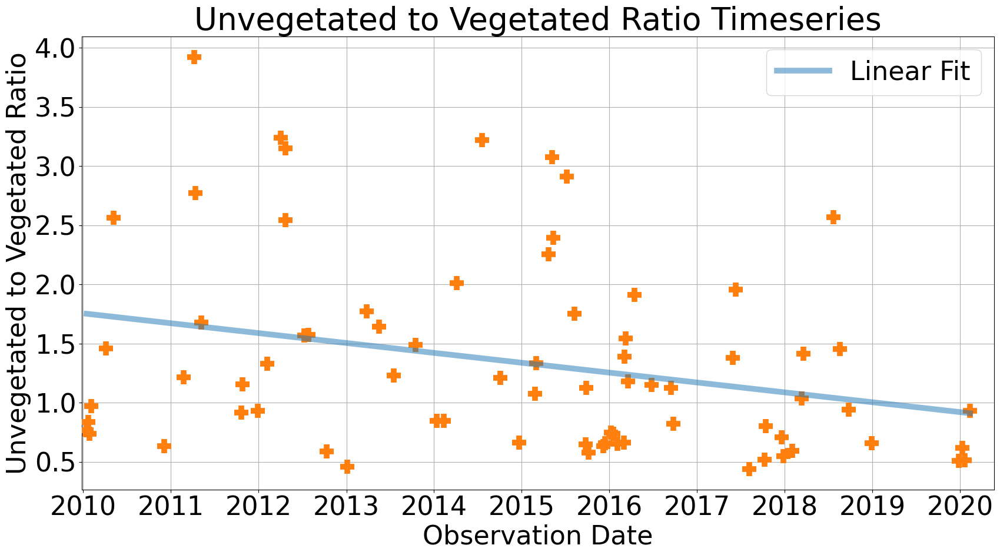

In [28]:
metrics_timeseries(df_uvvr, site_code, 'Unvegetated to Vegetated Ratio Timeseries', 'Unvegetated to Vegetated Ratio')

### NDVI Timeseries

In [29]:
df_NDVI = ndvi_calc(times, [obs], aoi_list)
df_NDVI['days_from_start'] = (df_NDVI['dates'] - df_NDVI['dates'][0]).dt.days

In [30]:
# Dropping drought years for linear fit to ignore drought effects
#drought_points = df_NDVI_all[(df_NDVI_all['dates'] >= np.datetime64('2013-01-01')) & (df_NDVI_all['dates'] <= np.datetime64('2016-01-01'))]
#df_ndvi_drought = df_NDVI_all.drop(drought_points.index)

df_NDVI['linfit'] = linear_fit(df_NDVI, site_code)[0]
# Interpolate missing date values for fit without drought points
df_NDVI['dates'] = pd.to_datetime(df_NDVI['dates'])

dates_backup = copy.deepcopy(df_NDVI['dates'].values)


df_NDVI.set_index('dates', inplace=True)
df_NDVI['linfit'] = df_NDVI['linfit'].interpolate(method='time')

df_NDVI['ndates'] = dates_backup
df_NDVI.head()

,GPHT,days_from_start,linfit,ndates
dates,,,,
2010-01-15,0.43775854,0,0.315135,2010-01-15
2010-01-23,0.4250409,8,0.315308,2010-01-23
2010-01-28,0.43804786,13,0.315416,2010-01-28
2010-02-02,0.38778406,18,0.315524,2010-02-02
2010-04-05,0.22314467,80,0.316864,2010-04-05


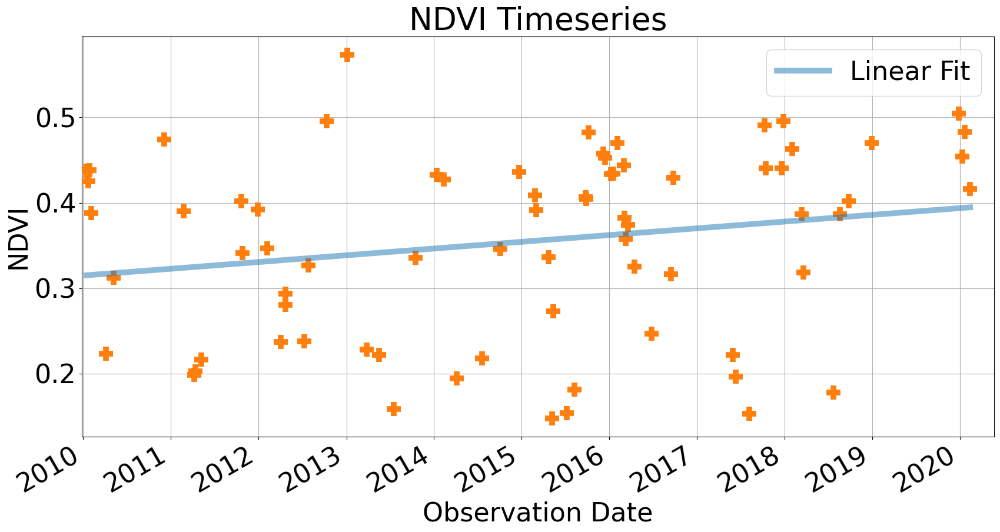

In [31]:
metrics_timeseries(df_NDVI, site_code, 'NDVI Timeseries', 'NDVI')

In [32]:
df_NDVI.to_csv(CLASSIFIED_PREFIX+site_code+'_NDVI.csv')
df_uvvr.to_csv(CLASSIFIED_PREFIX+site_code+'_UVVR.csv')